# Integrate All ten datasets in one Visualization (~500k cells)

### Import modules, set paths, load files:

In [1]:
# !pip install scanpy
# !pip install ipywidgets
import scanpy as sc
import anndata
import numpy as np
import pandas as pd
import os

from tqdm import tqdm

In [2]:
# !pip install scarches
# !pip install -U pandas==2.0

import scarches as sca

 captum (see https://github.com/pytorch/captum).


In [3]:
# https://github.com/huggingface/transformers/issues/29763
# pip install transformers==4.37.2
import torch

In [4]:
import warnings

warnings.simplefilter(action="ignore", category=FutureWarning)
warnings.simplefilter(action="ignore", category=UserWarning)

# [UCE_4] Train a model based on 
## high_level cell type label

In [7]:
path_input_data = '/home/fanhuan/data/BioInfo/453k/UCE_results/simple_model/all-with_annotation-processed-UCE.h5adall-with_annotation-processed_uce_adata.h5ad'
simple_UCE = sc.read(path_input_data)

adata_fragments = sc.read('/home/fanhuan/data/BioInfo/453k/train-with_annotation-processed-cell_type_high.h5ad')
adata_fragments.obsm['X_uce'] = simple_UCE.obsm['X_uce']
del adata_fragments.obsm['X_umap']
adata_fragments

AnnData object with n_obs × n_vars = 259531 × 53221
    obs: 'cell_type', 'cell_type_high', 'cell_type_detail', 'file_label', 'batch', 'n_genes', 'conditions_combined'
    var: 'hugo_symbol', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cell_type_colors', 'cell_type_detail_colors', 'cell_type_high_colors', 'hvg', 'log1p', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_uce'
    layers: 'spliced', 'spliced_unspliced_sum', 'unspliced'
    obsp: 'connectivities', 'distances'

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


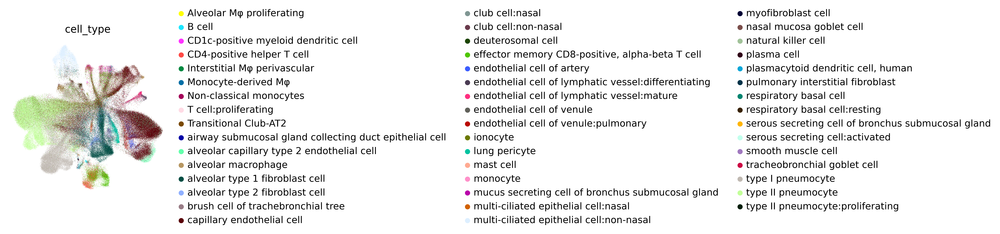

In [8]:
sc.pp.neighbors(adata_fragments, use_rep = 'X_uce')
sc.tl.umap(adata_fragments)

sc.pl.umap(adata_fragments, color=['cell_type'], wspace=0.5, frameon=False)

In [9]:
condition_key = 'cell_type_high'
cell_type_key = 'cell_type_high'

from scarches.models.scpoli._utils import reads_to_fragments
# adata_fragments = reads_to_fragments(simple_UCE, copy=True)
# adata_fragments = sc.read('/home/fanhuan/data/BioInfo/453k/train-with_annotation-processed-cell_type_high.h5ad')

# adata_fragments.write_h5ad(
#     '/home/fanhuan/data/BioInfo/453k/UCE_4-train-with_annotation-processed-cell_type_high.h5ad'
# )
# adata_fragments = sc.read('/home/fanhuan/data/BioInfo/453k/UCE_4-train-with_annotation-processed-cell_type_high.h5ad')

from scarches.models.scpoli import scPoli

scpoli_model = scPoli(
    adata=adata_fragments,
    condition_keys=condition_key,
    cell_type_keys=cell_type_key,
    hidden_layer_sizes=[100],
    latent_dim=25,
    embedding_dims=5,
    recon_loss='poisson',
)

scpoli_model.train(
    n_epochs=100
)

#get latent representation of reference data
scpoli_model.model.eval()
data_latent = scpoli_model.get_latent(
    adata_fragments,
    mean=True
)

adata_latent = sc.AnnData(data_latent)
adata_latent.obs = adata_fragments.obs.copy()
sc.pp.pca(adata_latent)
sc.pp.neighbors(adata_latent)
sc.tl.umap(adata_latent)

Embedding dictionary:
 	Num conditions: [7]
 	Embedding dim: [5]
Encoder Architecture:
	Input Layer in, out and cond: 53221 100 5
	Mean/Var Layer in/out: 100 25
Decoder Architecture:
	First Layer in, out and cond:  25 100 5
	Output Layer in/out:  100 53221 



INFO:scarches.trainers.scpoli.trainer:GPU available: True, GPU used: True


Initializing dataloaders
Starting training
 |████████████████████| 100.0%  - val_loss: 12332.08 - val_cvae_loss: 12319.85 - val_prototype_loss:   12.23 - val_labeled_loss:   12.23


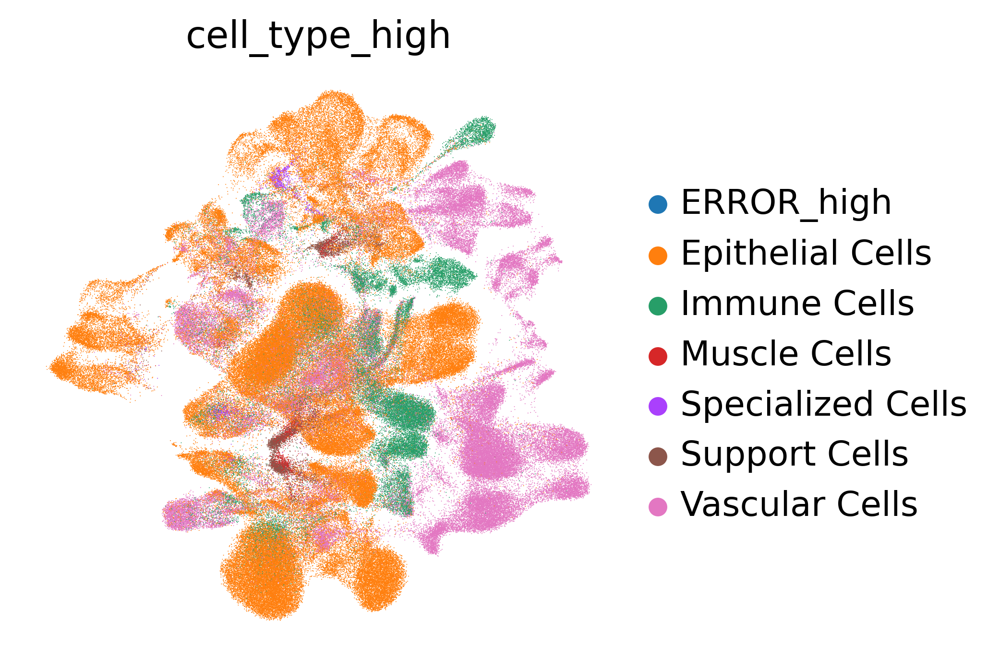

In [10]:
sc.pl.umap(adata_latent, color='cell_type_high', wspace=0.5, frameon=False)
# sc.pl.umap(adata_latent, color=['cell_type_high'], frameon=False, legend_loc = 'best')

## On detailed_level

In [7]:
path_input_data = '/home/fanhuan/data/BioInfo/453k/UCE_results/simple_model/all-with_annotation-processed-UCE.h5adall-with_annotation-processed_uce_adata.h5ad'
simple_UCE = sc.read(path_input_data)

adata_fragments = sc.read('/home/fanhuan/data/BioInfo/453k/train-with_annotation-processed-cell_type_high.h5ad')
adata_fragments.obsm['X_uce'] = simple_UCE.obsm['X_uce']
del adata_fragments.obsm['X_umap']
adata_fragments

AnnData object with n_obs × n_vars = 259531 × 53221
    obs: 'cell_type', 'cell_type_high', 'cell_type_detail', 'file_label', 'batch', 'n_genes', 'conditions_combined'
    var: 'hugo_symbol', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cell_type_colors', 'cell_type_detail_colors', 'cell_type_high_colors', 'hvg', 'log1p', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_uce'
    layers: 'spliced', 'spliced_unspliced_sum', 'unspliced'
    obsp: 'connectivities', 'distances'

In [8]:
condition_key = 'cell_type_detail'
cell_type_key = 'cell_type_detail'

from scarches.models.scpoli._utils import reads_to_fragments
# adata_fragments = reads_to_fragments(simple_UCE, copy=True)
# adata_fragments = sc.read('/home/fanhuan/data/BioInfo/453k/train-with_annotation-processed-cell_type_high.h5ad')

# adata_fragments.write_h5ad(
#     '/home/fanhuan/data/BioInfo/453k/UCE_4-train-with_annotation-processed-cell_type_high.h5ad'
# )
# adata_fragments = sc.read('/home/fanhuan/data/BioInfo/453k/UCE_4-train-with_annotation-processed-cell_type_high.h5ad')

from scarches.models.scpoli import scPoli

scpoli_model = scPoli(
    adata=adata_fragments,
    condition_keys=condition_key,
    cell_type_keys=cell_type_key,
    hidden_layer_sizes=[100],
    latent_dim=25,
    embedding_dims=5,
    recon_loss='poisson',
)

scpoli_model.train(
    n_epochs=100
)

#get latent representation of reference data
scpoli_model.model.eval()
data_latent = scpoli_model.get_latent(
    adata_fragments,
    mean=True
)

adata_latent = sc.AnnData(data_latent)
adata_latent.obs = adata_fragments.obs.copy()
sc.pp.pca(adata_latent)
sc.pp.neighbors(adata_latent)
sc.tl.umap(adata_latent)

Embedding dictionary:
 	Num conditions: [16]
 	Embedding dim: [5]
Encoder Architecture:
	Input Layer in, out and cond: 53221 100 5
	Mean/Var Layer in/out: 100 25
Decoder Architecture:
	First Layer in, out and cond:  25 100 5
	Output Layer in/out:  100 53221 



INFO:scarches.trainers.scpoli.trainer:GPU available: True, GPU used: True


Initializing dataloaders
Starting training
 |████████████████████| 100.0%  - val_loss: 12331.28 - val_cvae_loss: 12314.37 - val_prototype_loss:   16.90 - val_labeled_loss:   16.90


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


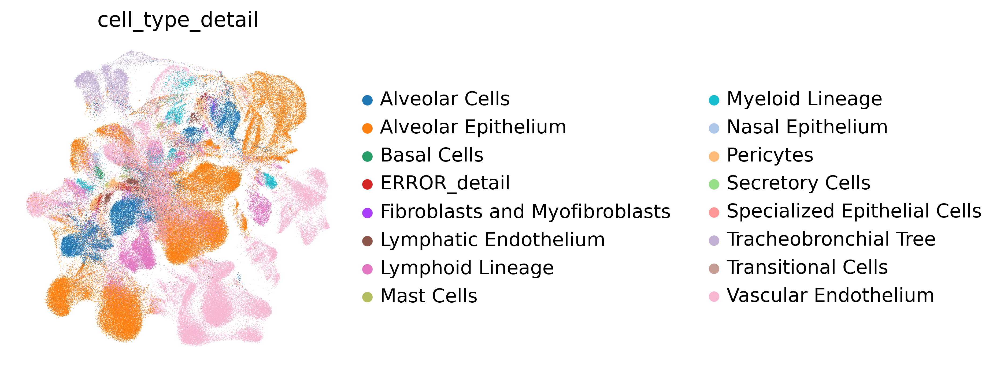

In [9]:
sc.pl.umap(adata_latent, color='cell_type_detail', wspace=0.5, frameon=False)

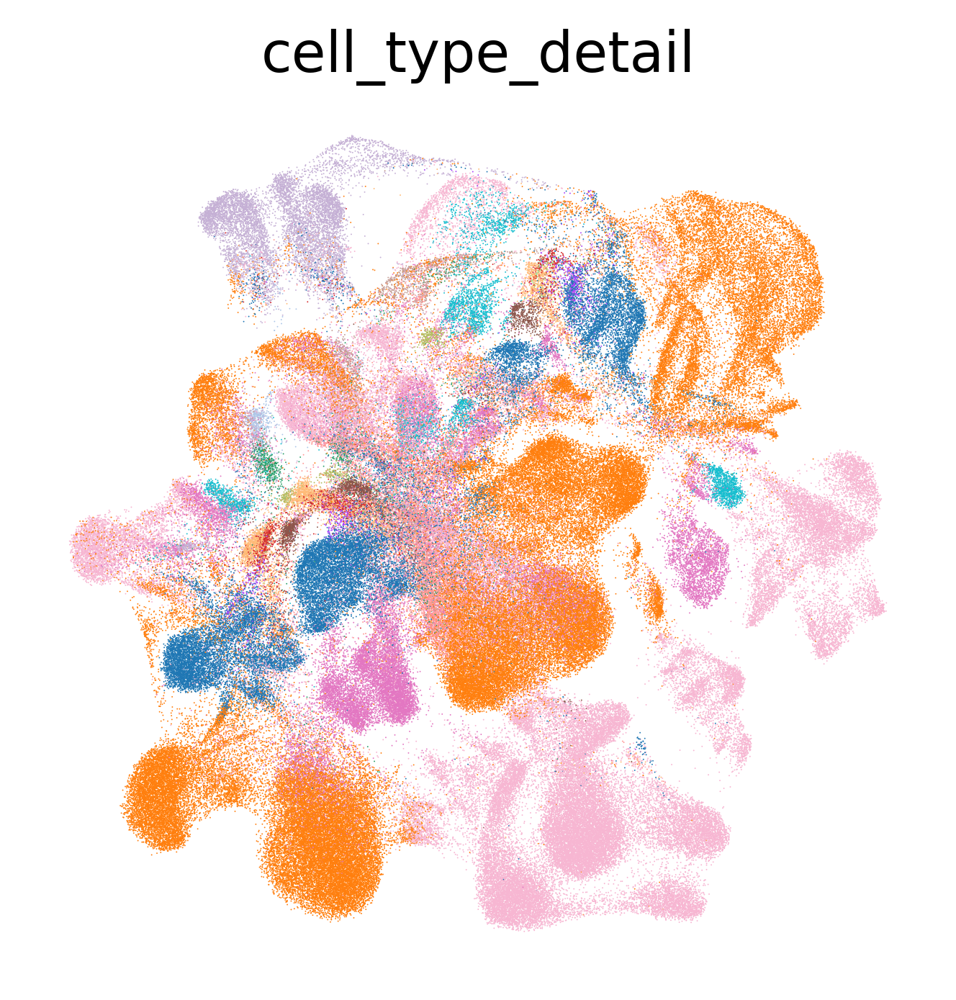

In [10]:
sc.pl.umap(adata_latent, color=['cell_type_detail'], frameon=False, legend_loc = 'best')

# [UCE_33] Train a model based on 
##  detailed_level cell type label

In [11]:
path_input_data = '/home/fanhuan/data/BioInfo/453k/UCE_results/better_model/all-with_annotation-processed_uce_adata.h5ad'
better_UCE = sc.read(path_input_data)

adata_fragments = sc.read('/home/fanhuan/data/BioInfo/453k/train-with_annotation-processed-cell_type_high.h5ad')
adata_fragments.obsm['X_uce'] = better_UCE.obsm['X_uce']
del adata_fragments.obsm['X_umap']
adata_fragments

AnnData object with n_obs × n_vars = 259531 × 53221
    obs: 'cell_type', 'cell_type_high', 'cell_type_detail', 'file_label', 'batch', 'n_genes', 'conditions_combined'
    var: 'hugo_symbol', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cell_type_colors', 'cell_type_detail_colors', 'cell_type_high_colors', 'hvg', 'log1p', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_uce'
    layers: 'spliced', 'spliced_unspliced_sum', 'unspliced'
    obsp: 'connectivities', 'distances'

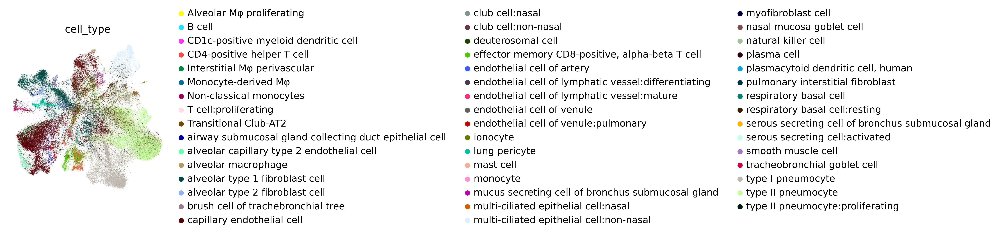

In [12]:
sc.pp.neighbors(adata_fragments, use_rep = 'X_uce')
sc.tl.umap(adata_fragments)

sc.pl.umap(adata_fragments, color=['cell_type'], wspace=0.5, frameon=False)

In [13]:
condition_key = 'cell_type_high'
cell_type_key = 'cell_type_high'

from scarches.models.scpoli._utils import reads_to_fragments
# adata_fragments = reads_to_fragments(simple_UCE, copy=True)
# adata_fragments = sc.read('/home/fanhuan/data/BioInfo/453k/train-with_annotation-processed-cell_type_high.h5ad')

# adata_fragments.write_h5ad(
#     '/home/fanhuan/data/BioInfo/453k/UCE_4-train-with_annotation-processed-cell_type_high.h5ad'
# )
# adata_fragments = sc.read('/home/fanhuan/data/BioInfo/453k/UCE_4-train-with_annotation-processed-cell_type_high.h5ad')

from scarches.models.scpoli import scPoli

scpoli_model = scPoli(
    adata=adata_fragments,
    condition_keys=condition_key,
    cell_type_keys=cell_type_key,
    hidden_layer_sizes=[100],
    latent_dim=25,
    embedding_dims=5,
    recon_loss='poisson',
)

scpoli_model.train(
    n_epochs=100
)

#get latent representation of reference data
scpoli_model.model.eval()
data_latent = scpoli_model.get_latent(
    adata_fragments,
    mean=True
)

adata_latent = sc.AnnData(data_latent)
adata_latent.obs = adata_fragments.obs.copy()
sc.pp.pca(adata_latent)
sc.pp.neighbors(adata_latent)
sc.tl.umap(adata_latent)

INFO:scarches.trainers.scpoli.trainer:GPU available: True, GPU used: True


Embedding dictionary:
 	Num conditions: [7]
 	Embedding dim: [5]
Encoder Architecture:
	Input Layer in, out and cond: 53221 100 5
	Mean/Var Layer in/out: 100 25
Decoder Architecture:
	First Layer in, out and cond:  25 100 5
	Output Layer in/out:  100 53221 

Initializing dataloaders
Starting training
 |████████████████████| 100.0%  - val_loss: 12238.12 - val_cvae_loss: 12225.83 - val_prototype_loss:   12.29 - val_labeled_loss:   12.29


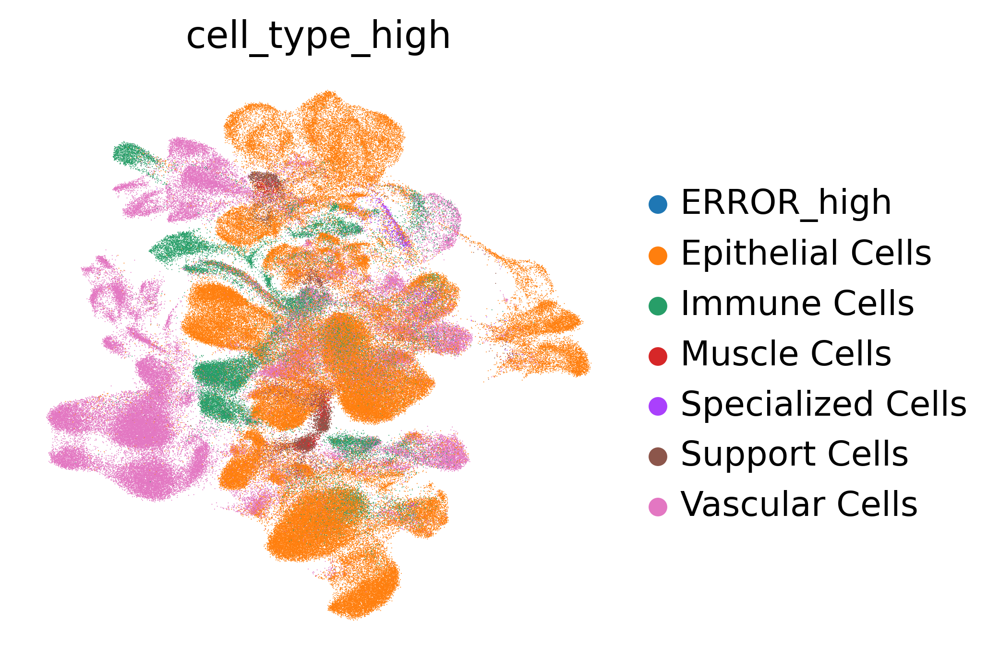

In [14]:
sc.pl.umap(adata_latent, color='cell_type_high', wspace=0.5, frameon=False)

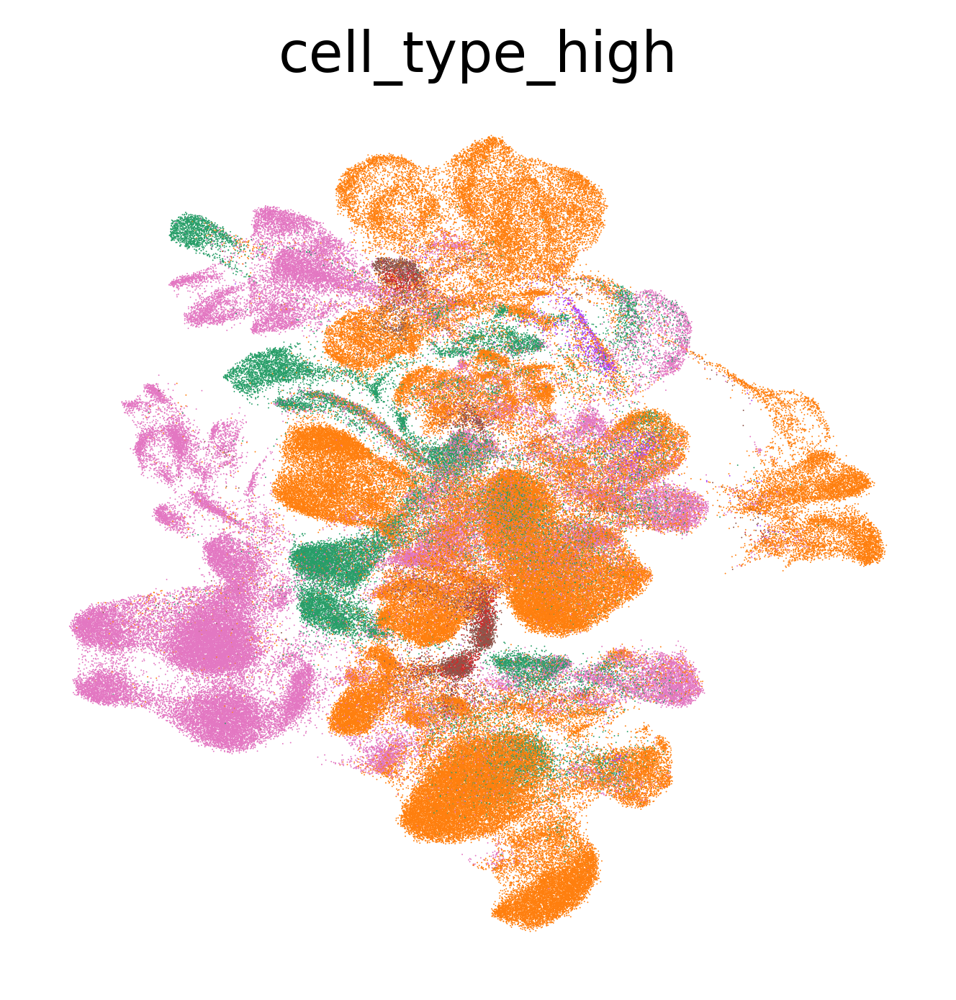

In [15]:
sc.pl.umap(adata_latent, color=['cell_type_high'], frameon=False, legend_loc = 'best')

## On detailed_level

In [16]:
path_input_data = '/home/fanhuan/data/BioInfo/453k/UCE_results/simple_model/all-with_annotation-processed-UCE.h5adall-with_annotation-processed_uce_adata.h5ad'
simple_UCE = sc.read(path_input_data)

adata_fragments = sc.read('/home/fanhuan/data/BioInfo/453k/train-with_annotation-processed-cell_type_high.h5ad')
adata_fragments.obsm['X_uce'] = simple_UCE.obsm['X_uce']
del adata_fragments.obsm['X_umap']
adata_fragments

AnnData object with n_obs × n_vars = 259531 × 53221
    obs: 'cell_type', 'cell_type_high', 'cell_type_detail', 'file_label', 'batch', 'n_genes', 'conditions_combined'
    var: 'hugo_symbol', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cell_type_colors', 'cell_type_detail_colors', 'cell_type_high_colors', 'hvg', 'log1p', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_uce'
    layers: 'spliced', 'spliced_unspliced_sum', 'unspliced'
    obsp: 'connectivities', 'distances'

In [17]:
condition_key = 'cell_type_detail'
cell_type_key = 'cell_type_detail'

from scarches.models.scpoli._utils import reads_to_fragments
# adata_fragments = reads_to_fragments(simple_UCE, copy=True)
# adata_fragments = sc.read('/home/fanhuan/data/BioInfo/453k/train-with_annotation-processed-cell_type_high.h5ad')

# adata_fragments.write_h5ad(
#     '/home/fanhuan/data/BioInfo/453k/UCE_4-train-with_annotation-processed-cell_type_high.h5ad'
# )
# adata_fragments = sc.read('/home/fanhuan/data/BioInfo/453k/UCE_4-train-with_annotation-processed-cell_type_high.h5ad')

from scarches.models.scpoli import scPoli

scpoli_model = scPoli(
    adata=adata_fragments,
    condition_keys=condition_key,
    cell_type_keys=cell_type_key,
    hidden_layer_sizes=[100],
    latent_dim=25,
    embedding_dims=5,
    recon_loss='poisson',
)

scpoli_model.train(
    n_epochs=100
)

#get latent representation of reference data
scpoli_model.model.eval()
data_latent = scpoli_model.get_latent(
    adata_fragments,
    mean=True
)

adata_latent = sc.AnnData(data_latent)
adata_latent.obs = adata_fragments.obs.copy()
sc.pp.pca(adata_latent)
sc.pp.neighbors(adata_latent)
sc.tl.umap(adata_latent)

INFO:scarches.trainers.scpoli.trainer:GPU available: True, GPU used: True


Embedding dictionary:
 	Num conditions: [16]
 	Embedding dim: [5]
Encoder Architecture:
	Input Layer in, out and cond: 53221 100 5
	Mean/Var Layer in/out: 100 25
Decoder Architecture:
	First Layer in, out and cond:  25 100 5
	Output Layer in/out:  100 53221 

Initializing dataloaders
Starting training
 |████████████████████| 100.0%  - val_loss: 12366.26 - val_cvae_loss: 12349.05 - val_prototype_loss:   17.22 - val_labeled_loss:   17.22


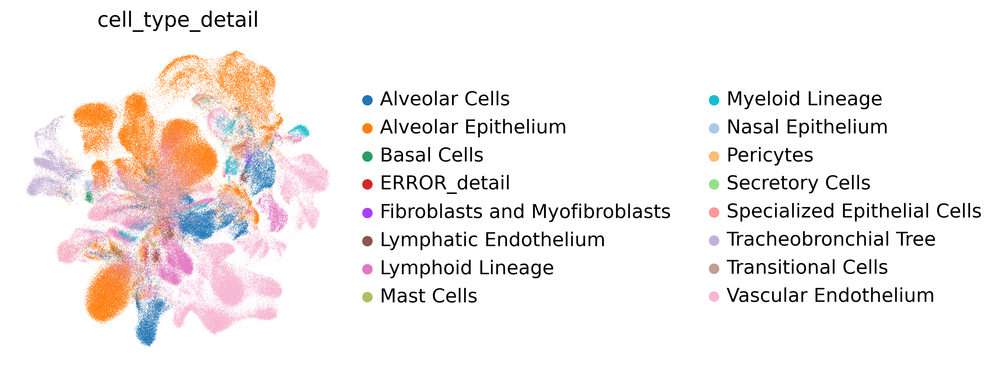

In [18]:
sc.pl.umap(adata_latent, color='cell_type_detail', wspace=0.5, frameon=False)

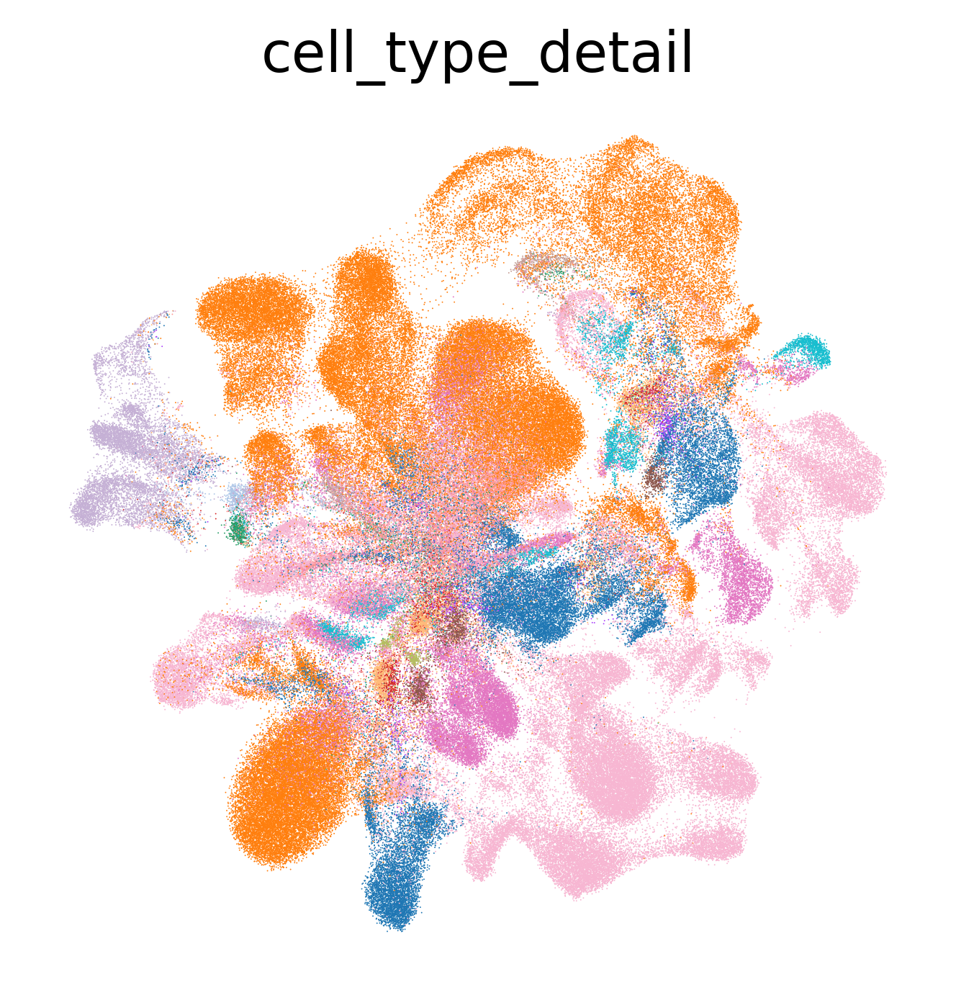

In [19]:
sc.pl.umap(adata_latent, color=['cell_type_detail'], frameon=False, legend_loc = 'best')